In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import glob
import os

In [3]:
# path to folder containing all images
basePath = "/scratch/groups/mrivas/ukbb24983/phenotypedata/2005693/41413/bulk/ukb2005693.41413.20202/pancreas_images_new/all_patients/"
file_names = os.listdir(basePath)

images = {}

for file_name in file_names[:100]:
        
    if '.npy' not in file_name:
        continue
        
    print(file_name)
    
    EID = file_name.split('.')[0]
        
    file_path = basePath + file_name
    
    image_list = np.load(file_path)
    
    images[EID] = image_list

2207519.npy
2586599.npy
2506918.npy
3321320.npy
3331687.npy
5777672.npy
2123114.npy
1405212.npy
4180420.npy
3276597.npy
3277395.npy
2884892.npy
5579251.npy
1859751.npy
4070399.npy
3959473.npy
3437629.npy
1381488.npy
2626153.npy
4155010.npy
2524989.npy
4986440.npy
2166045.npy
3277689.npy
1459752.npy
5006074.npy
5869255.npy
4034063.npy
3062802.npy
1341065.npy
2479827.npy
6020099.npy
2347999.npy
4840264.npy
3573091.npy
1908525.npy
4977301.npy
1303751.npy
2773633.npy
2677980.npy
4458616.npy
4899977.npy
6008916.npy
4771837.npy
1156516.npy
2216689.npy
1103499.npy
5004689.npy
2889009.npy
1869334.npy
2848845.npy
5762009.npy
3130652.npy
1521568.npy
4967118.npy
4808046.npy
3508170.npy
2445085.npy
3182894.npy
5837239.npy
4783445.npy
5283050.npy
5451730.npy
2403799.npy
3256707.npy
2262254.npy
4621999.npy
1748282.npy
2236160.npy
3730380.npy
4036441.npy
4258998.npy
2357124.npy
1656156.npy
2481295.npy
1375849.npy
4949855.npy
4453515.npy
4466374.npy
5522947.npy
1521423.npy
2189238.npy
6012443.npy
4599

1


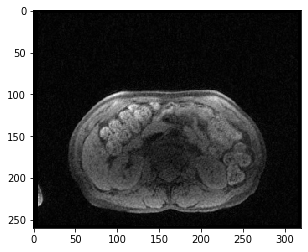

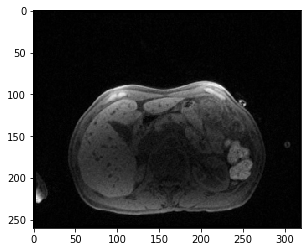

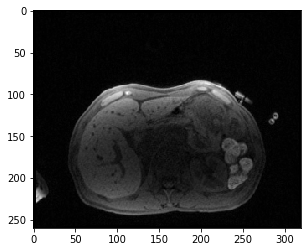

2


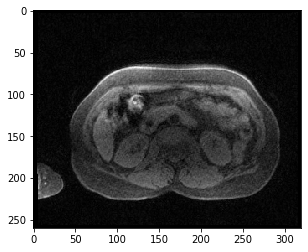

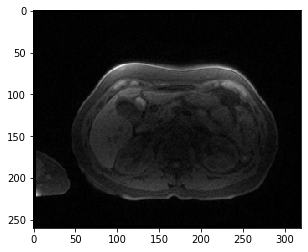

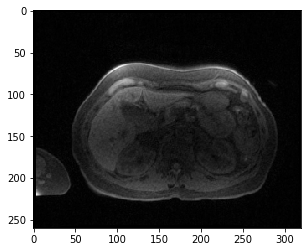

3


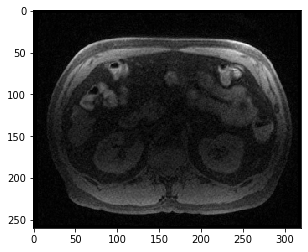

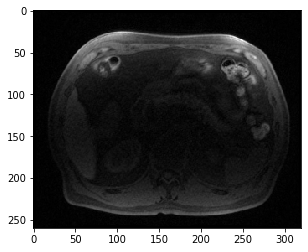

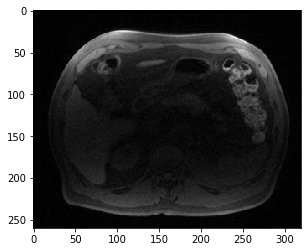

4


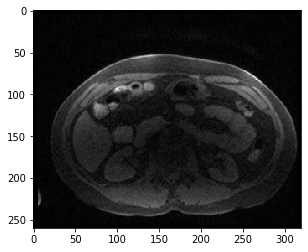

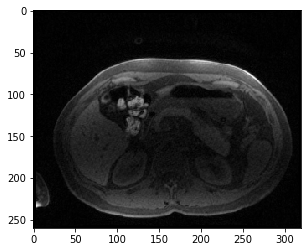

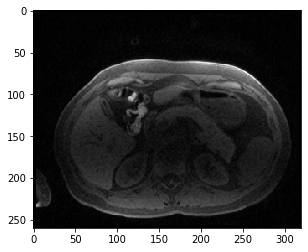

5


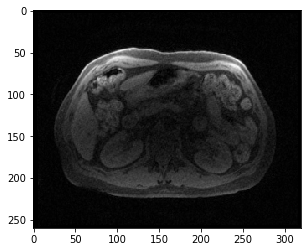

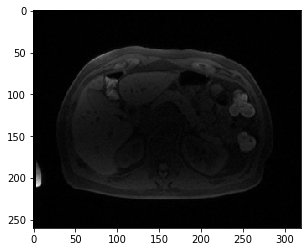

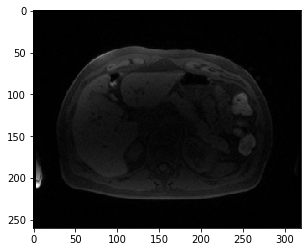

6


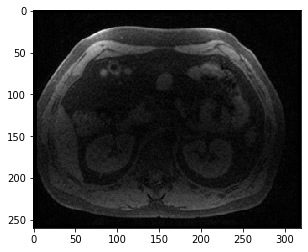

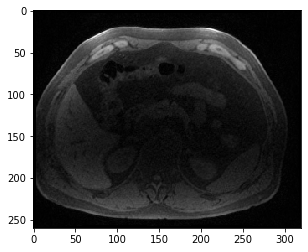

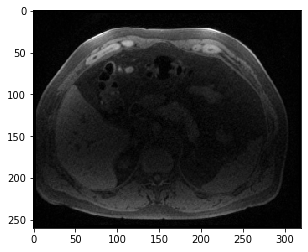

7


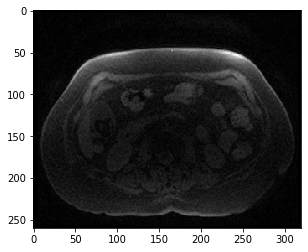

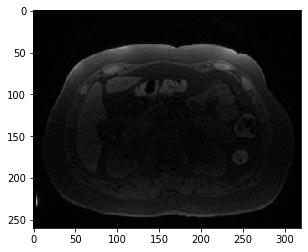

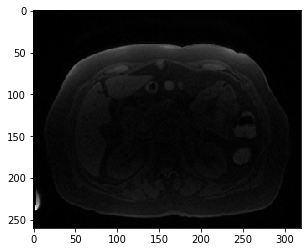

8


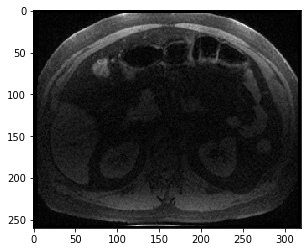

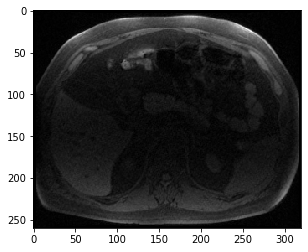

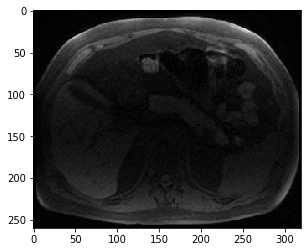

9


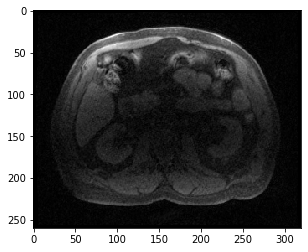

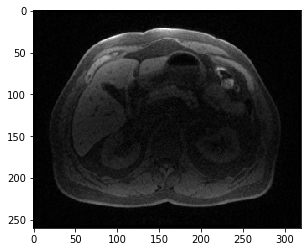

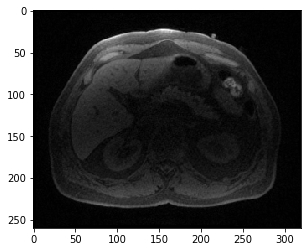

10


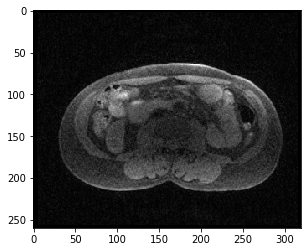

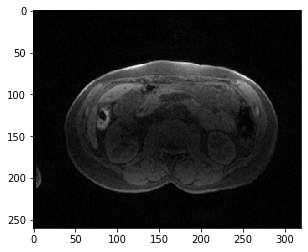

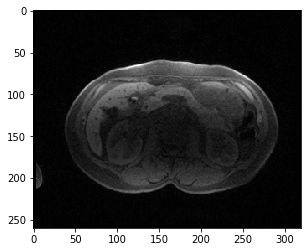

11


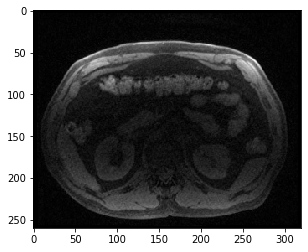

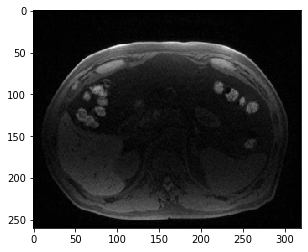

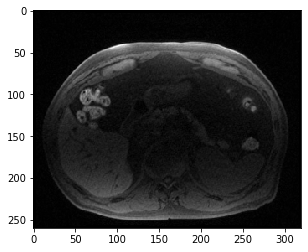

12


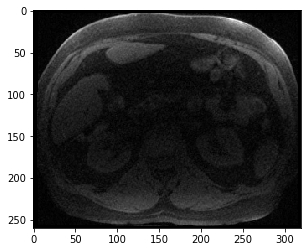

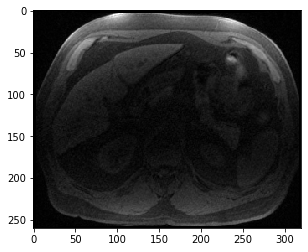

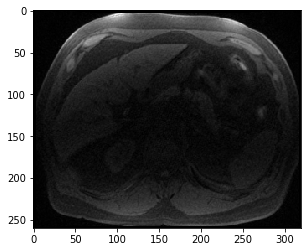

13


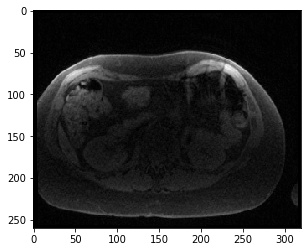

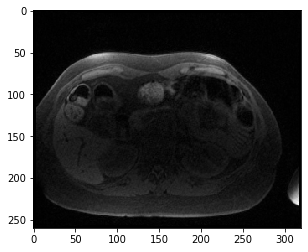

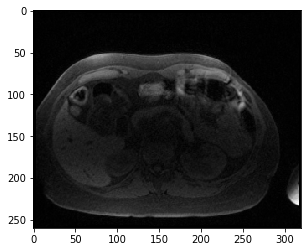

14


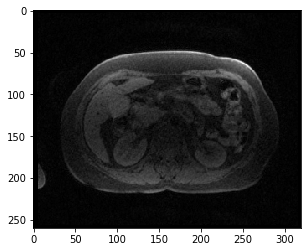

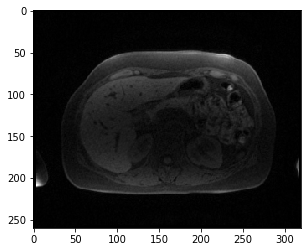

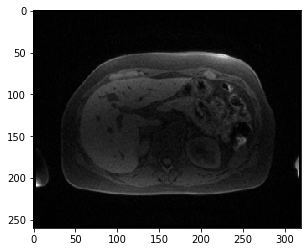

15


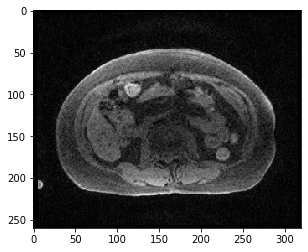

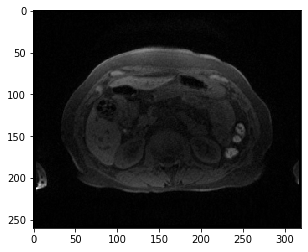

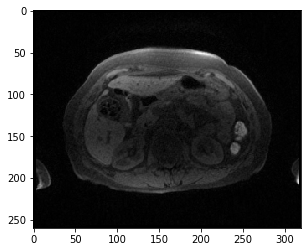

16


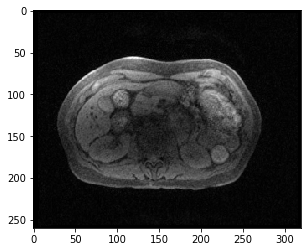

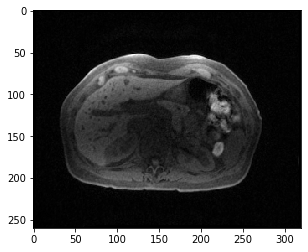

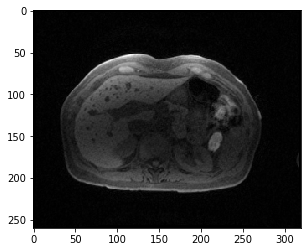

17


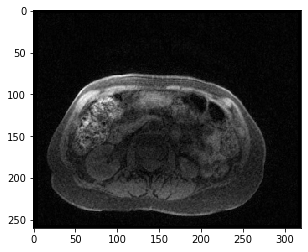

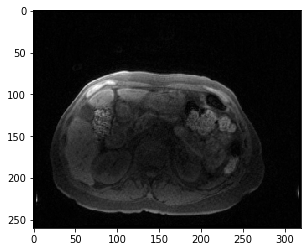

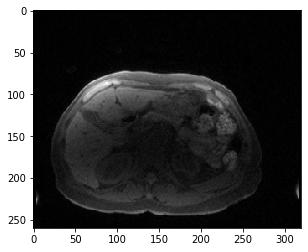

18


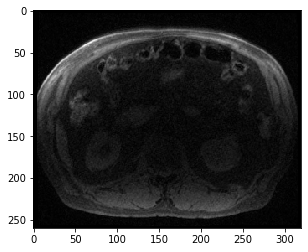

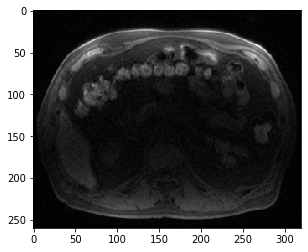

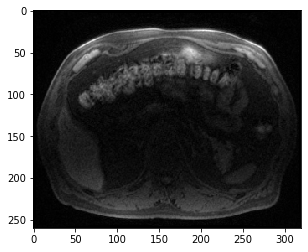

19


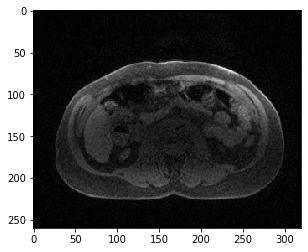

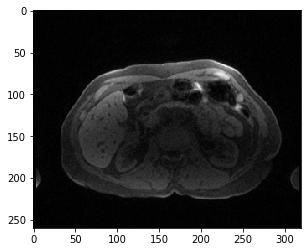

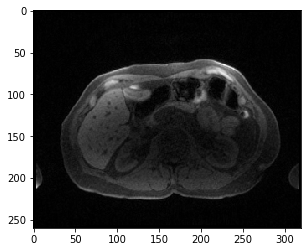

20


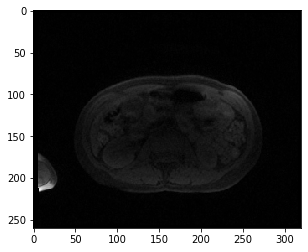

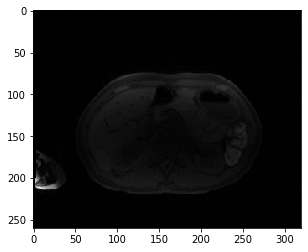

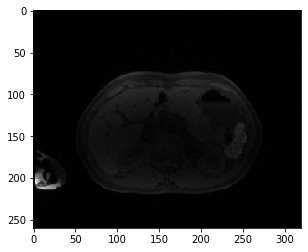

21


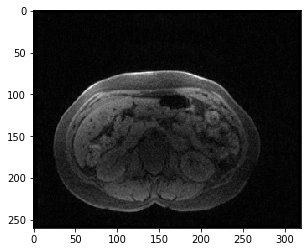

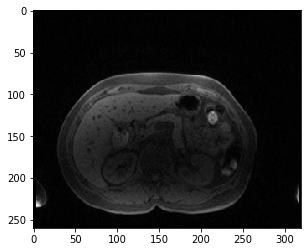

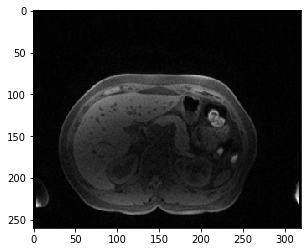

22


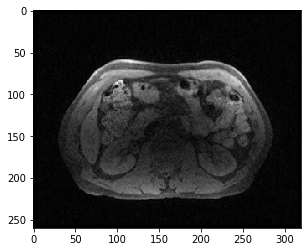

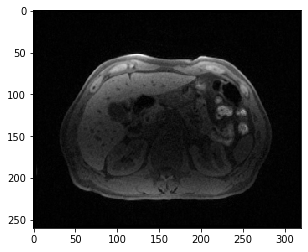

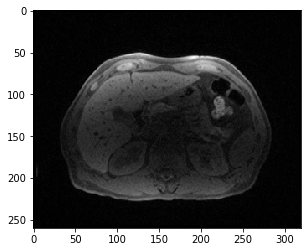

23


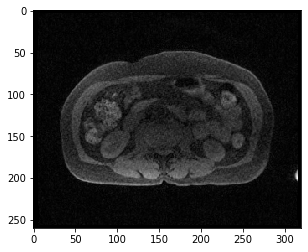

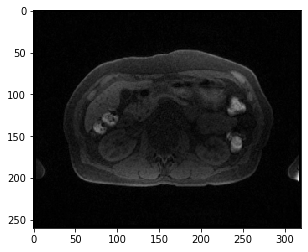

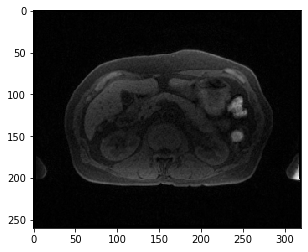

24


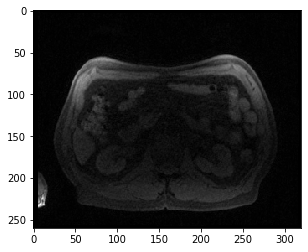

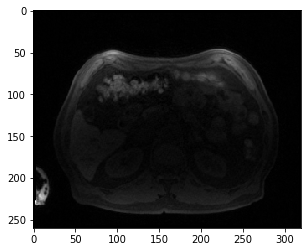

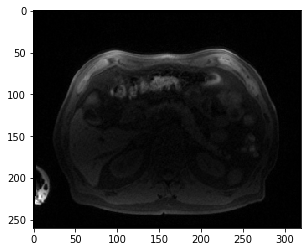

25


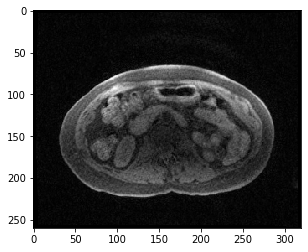

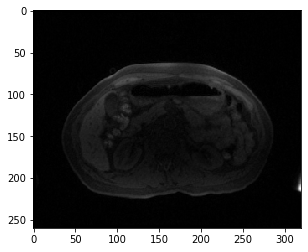

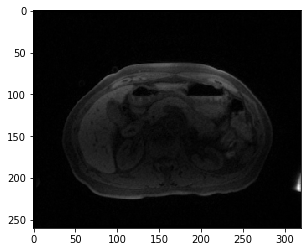

26


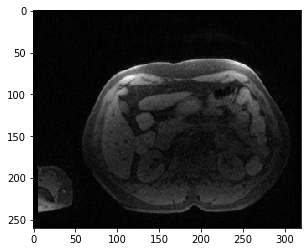

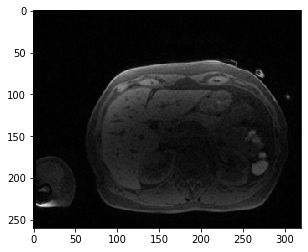

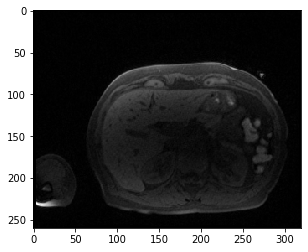

27


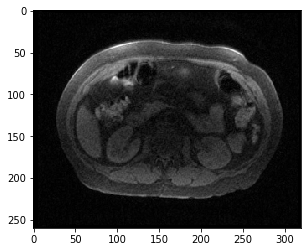

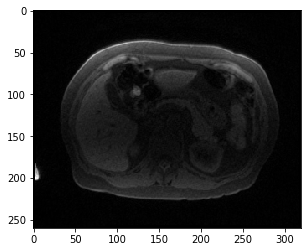

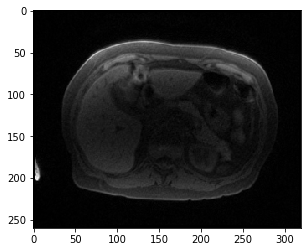

28


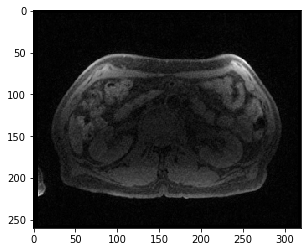

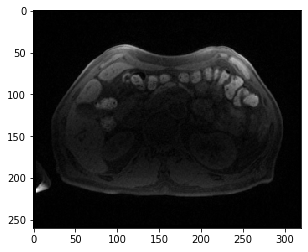

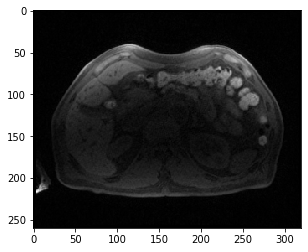

29


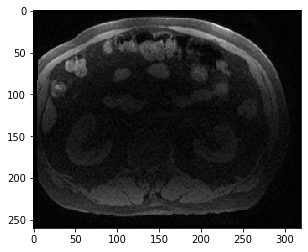

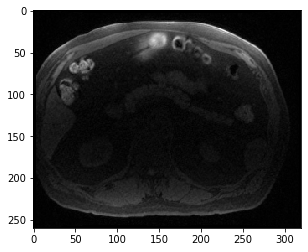

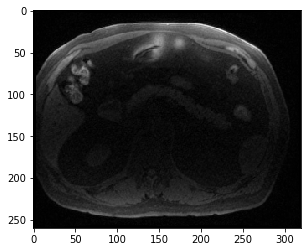

30


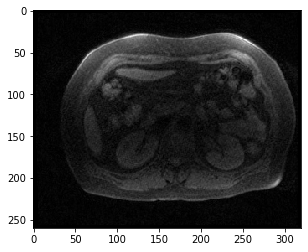

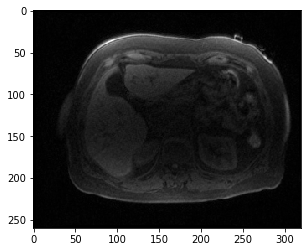

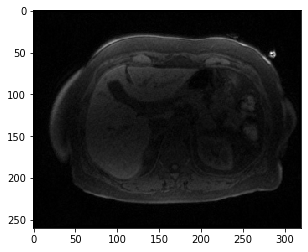

31


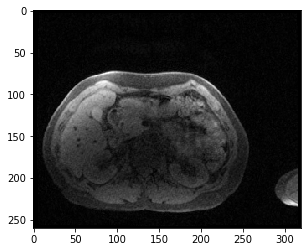

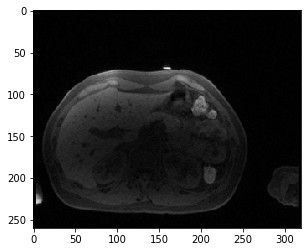

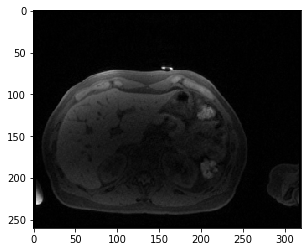

32


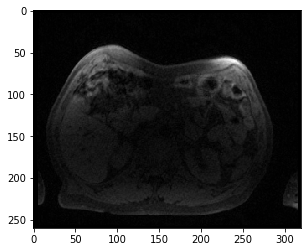

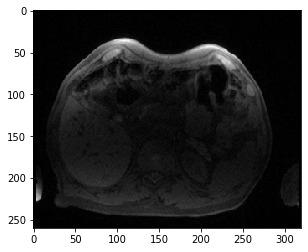

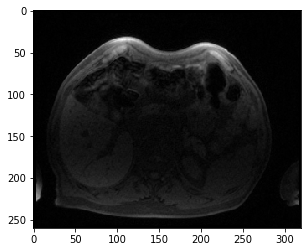

33


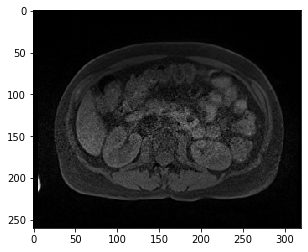

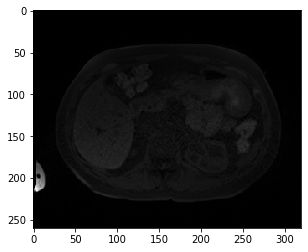

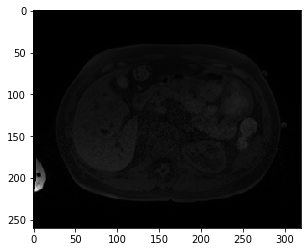

34


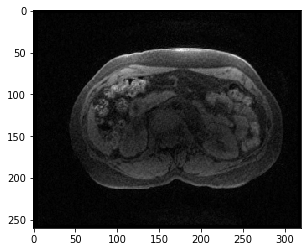

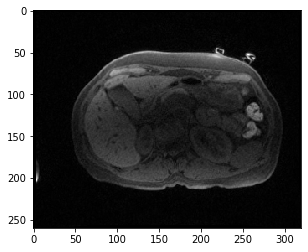

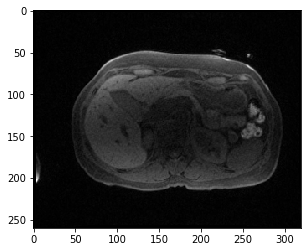

35


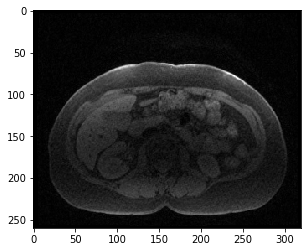

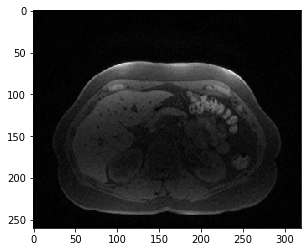

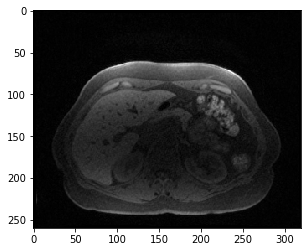

36


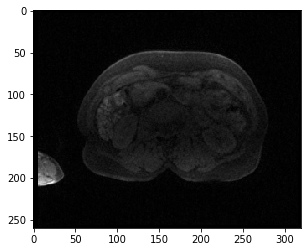

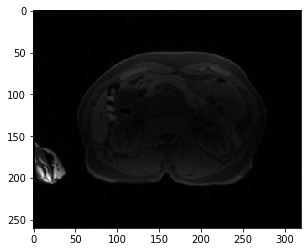

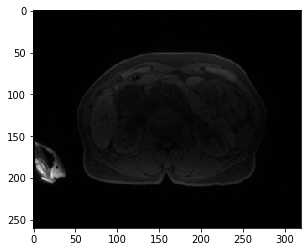

37


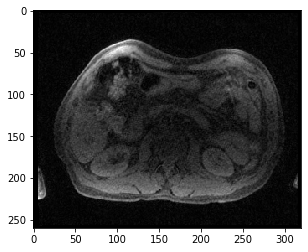

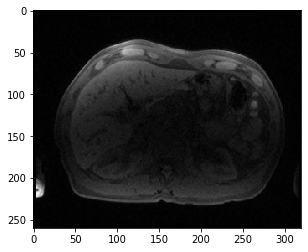

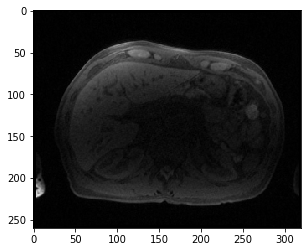

38


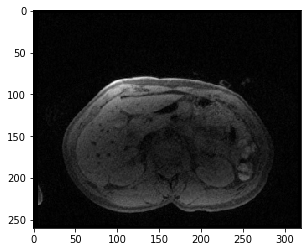

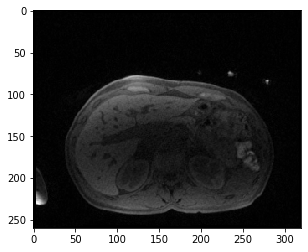

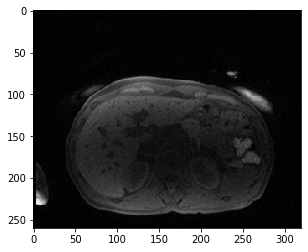

39


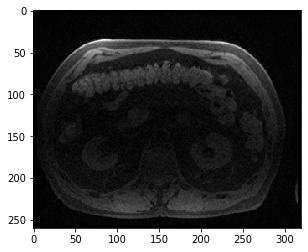

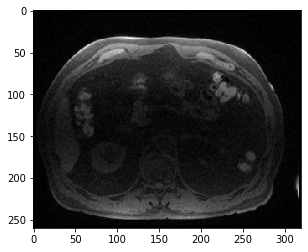

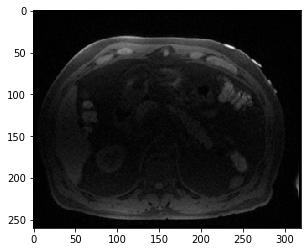

40


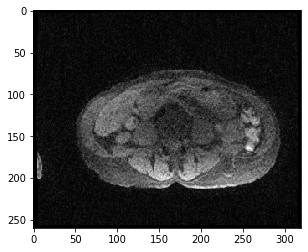

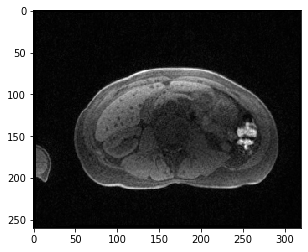

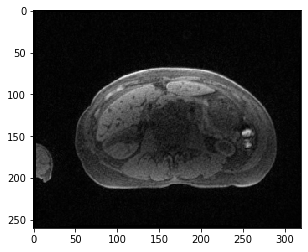

41


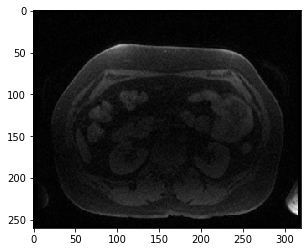

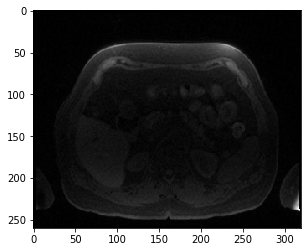

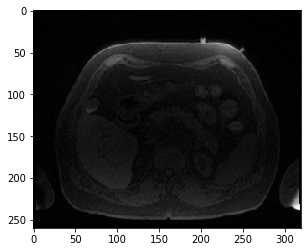

42


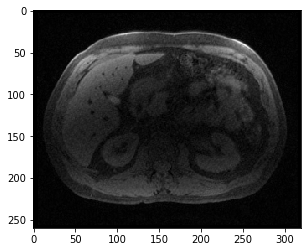

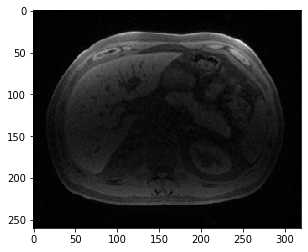

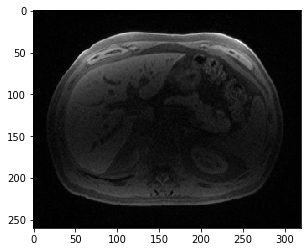

43


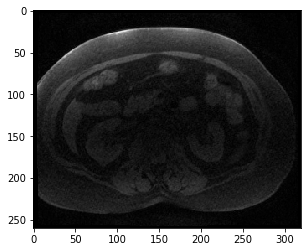

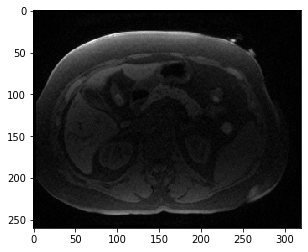

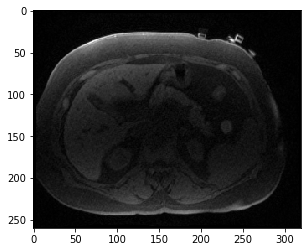

44


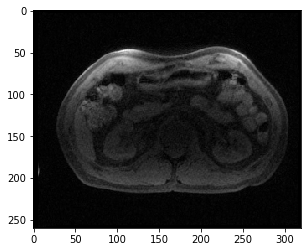

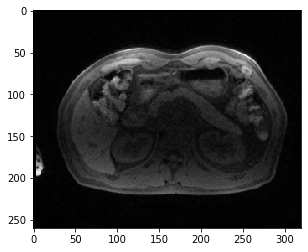

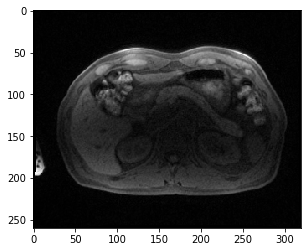

45


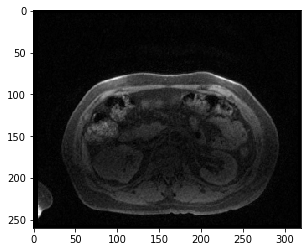

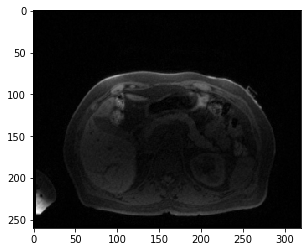

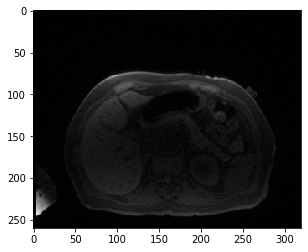

46


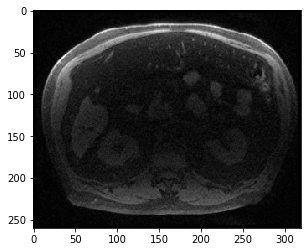

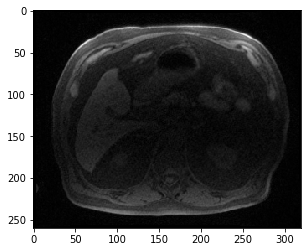

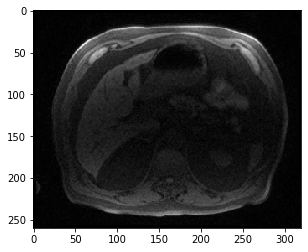

47


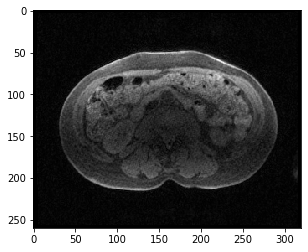

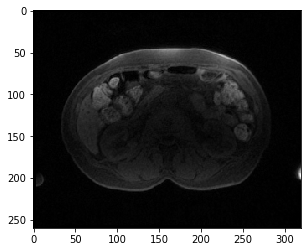

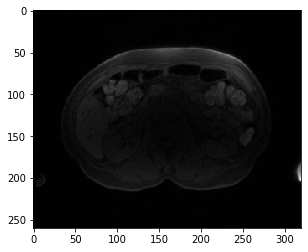

48


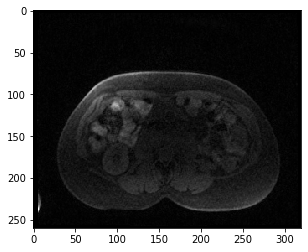

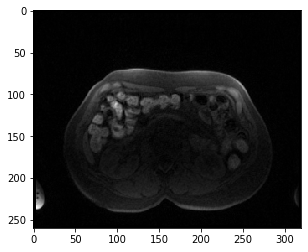

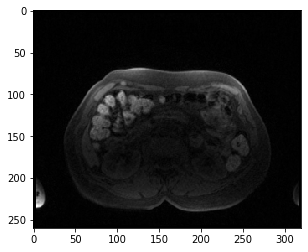

49


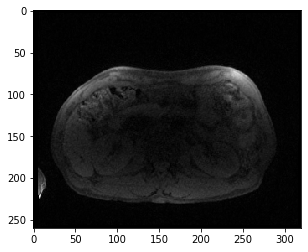

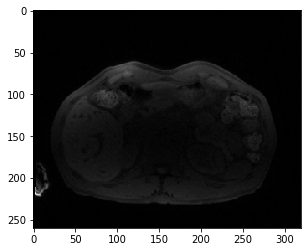

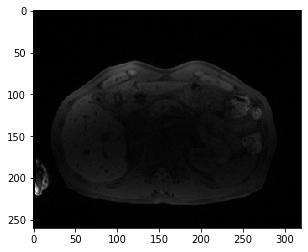

50


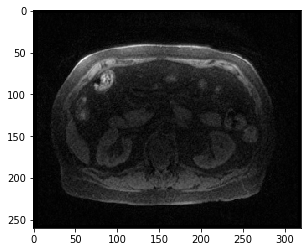

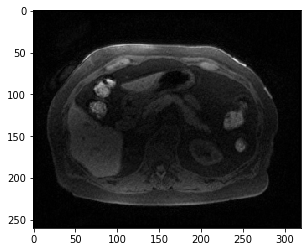

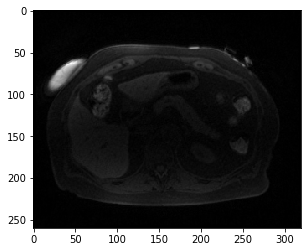

51


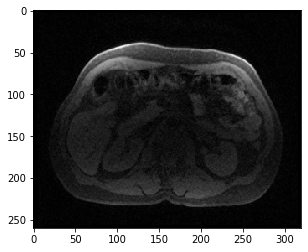

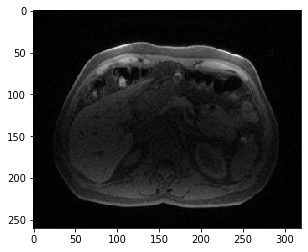

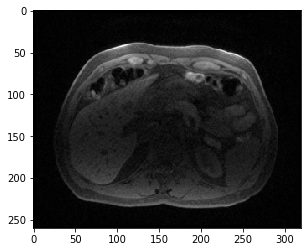

52


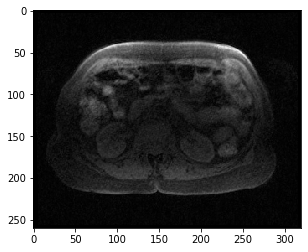

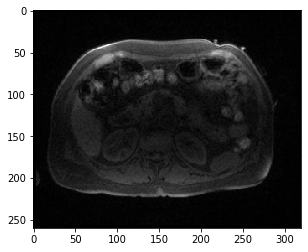

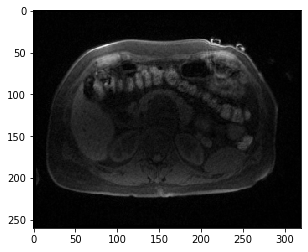

53


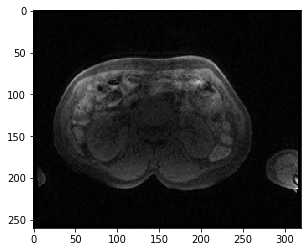

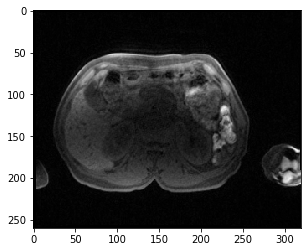

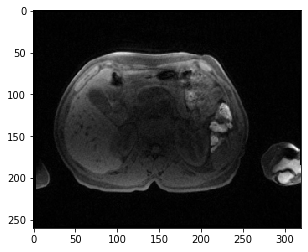

54


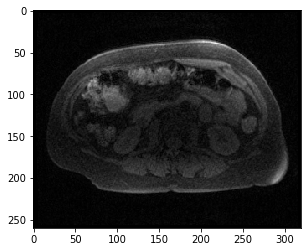

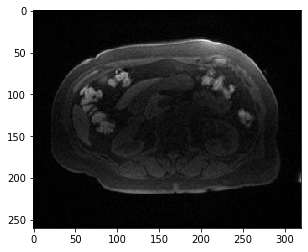

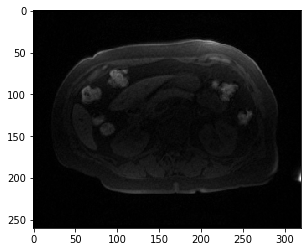

55


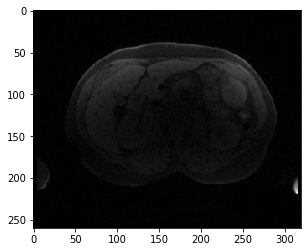

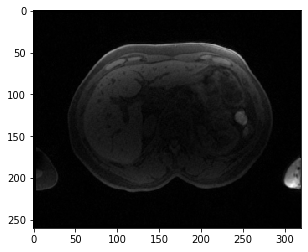

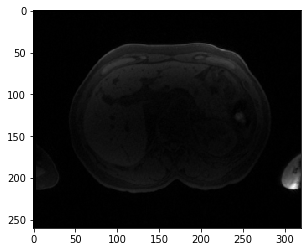

56


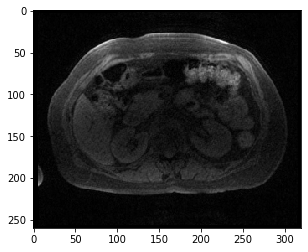

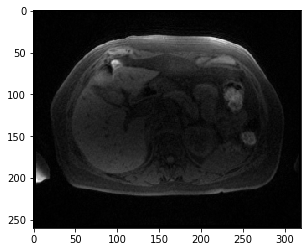

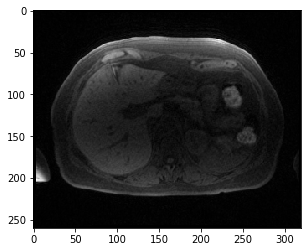

57


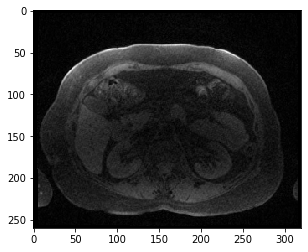

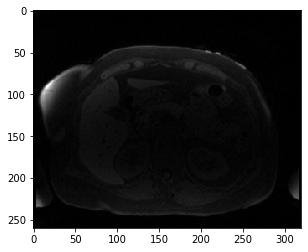

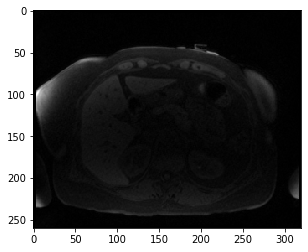

58


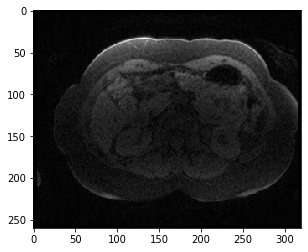

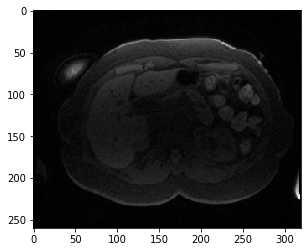

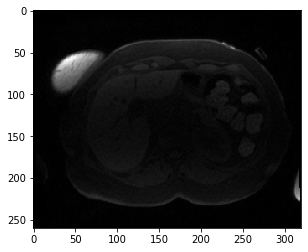

59


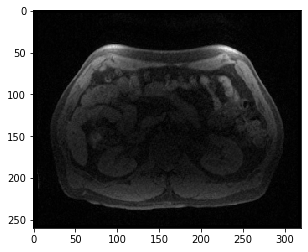

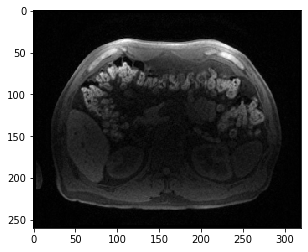

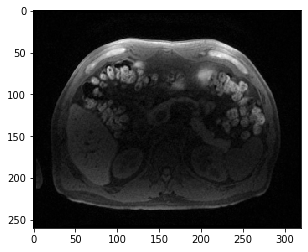

60


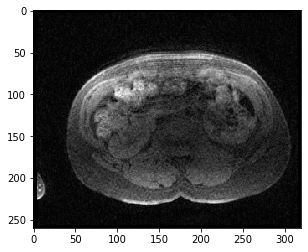

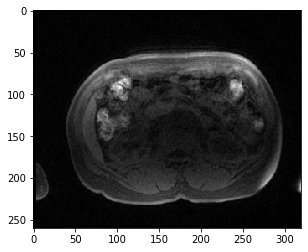

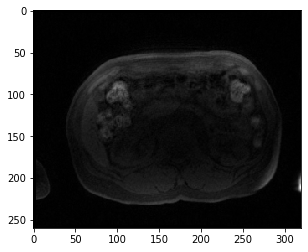

61


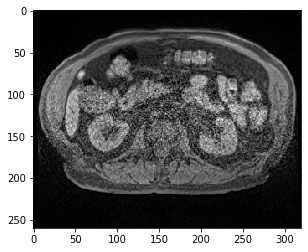

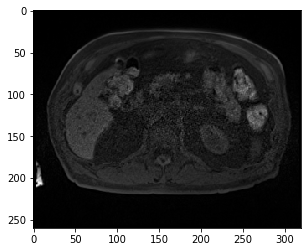

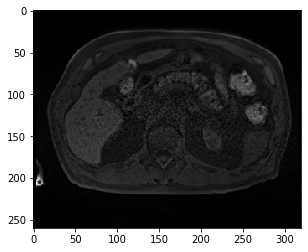

62


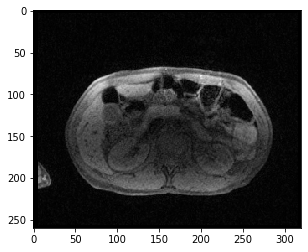

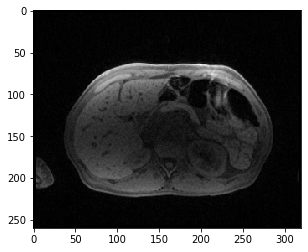

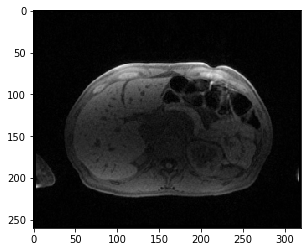

63


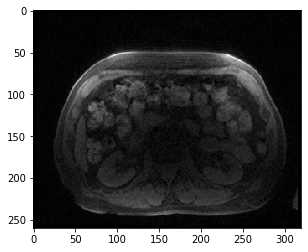

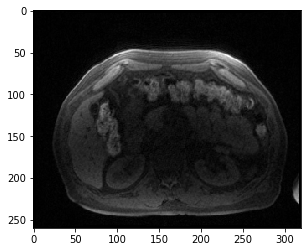

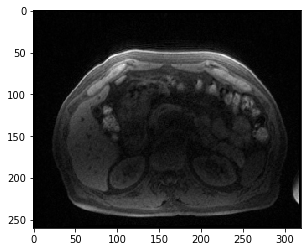

64


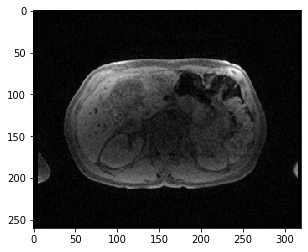

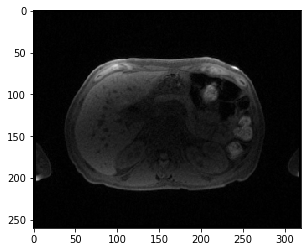

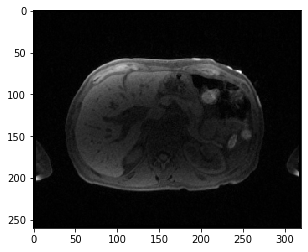

65


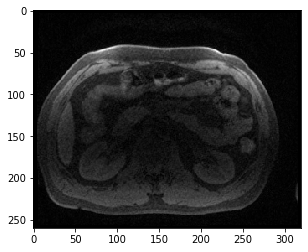

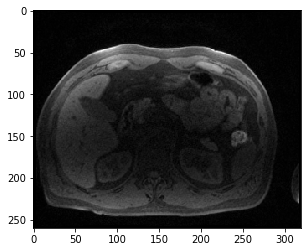

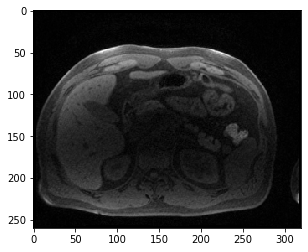

66


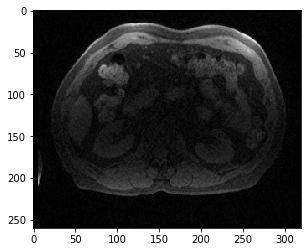

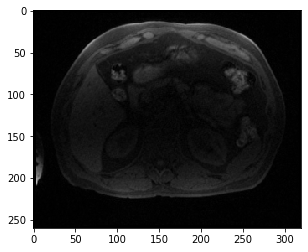

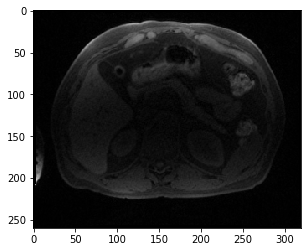

67


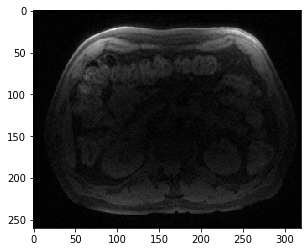

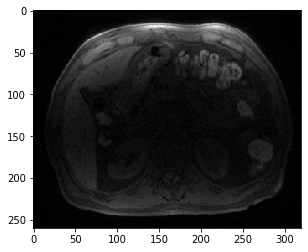

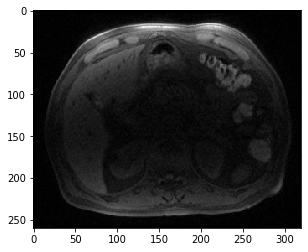

68


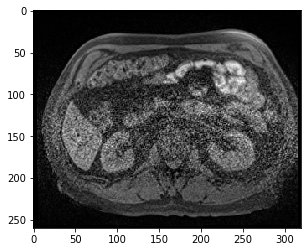

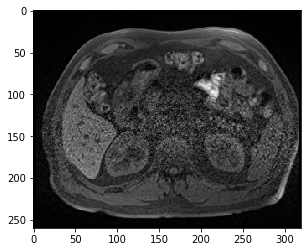

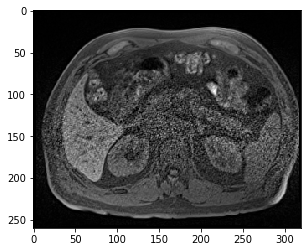

69


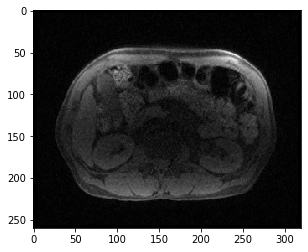

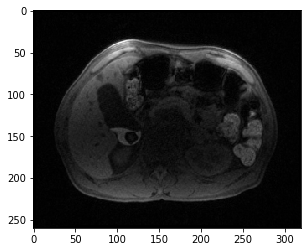

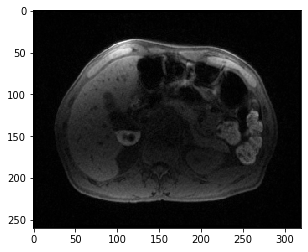

70


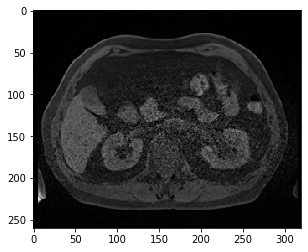

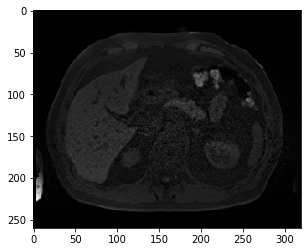

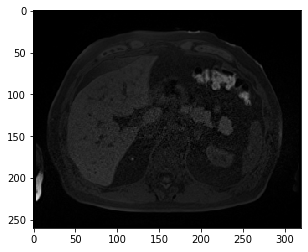

71


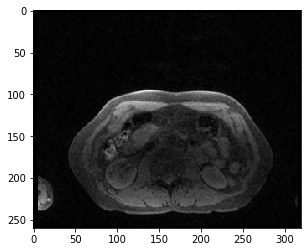

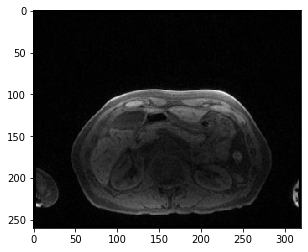

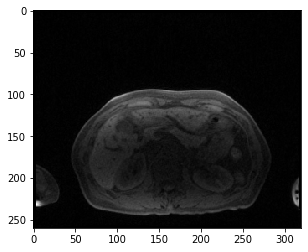

72


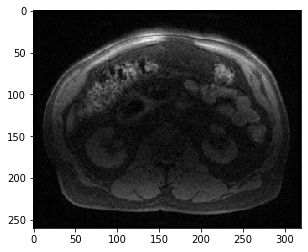

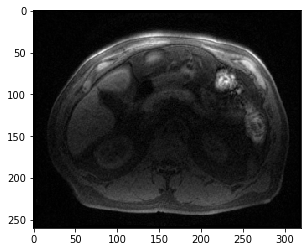

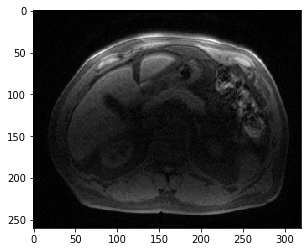

73


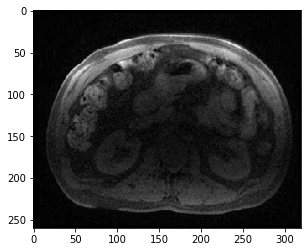

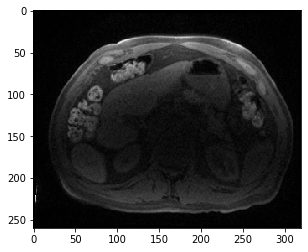

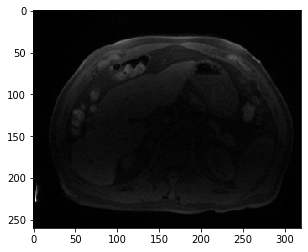

74


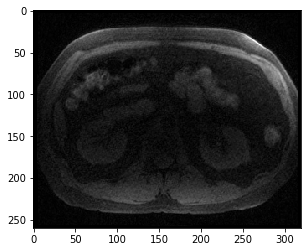

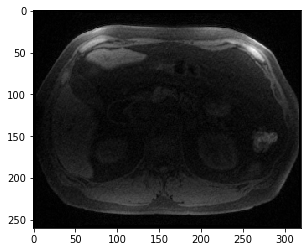

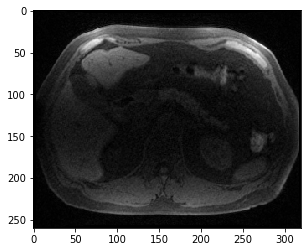

75


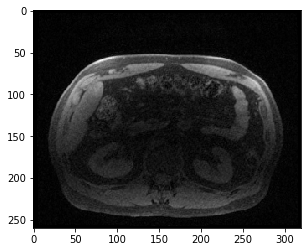

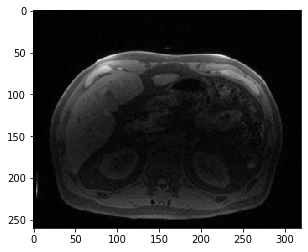

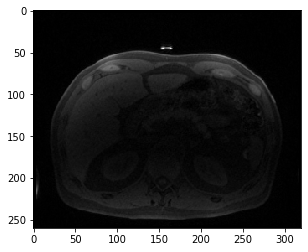

76


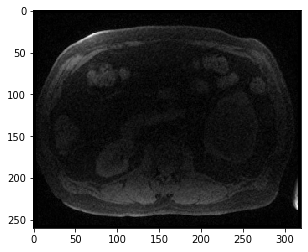

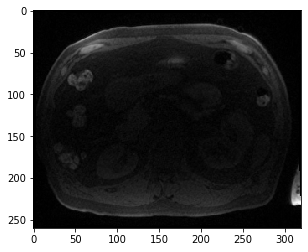

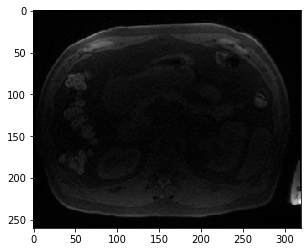

77


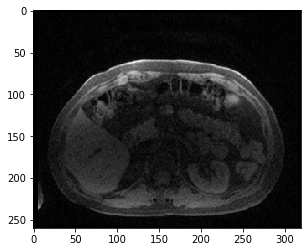

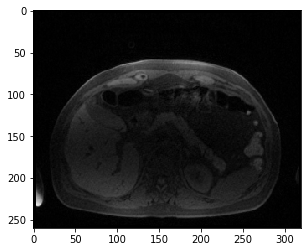

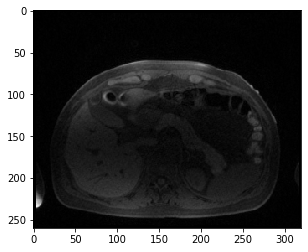

78


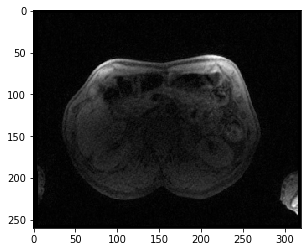

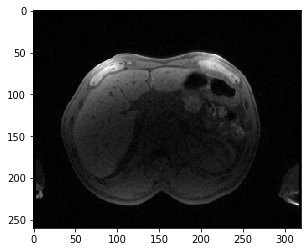

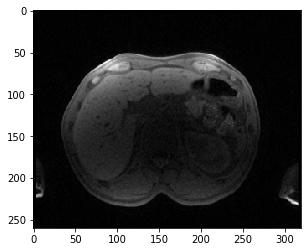

79


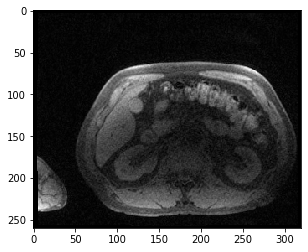

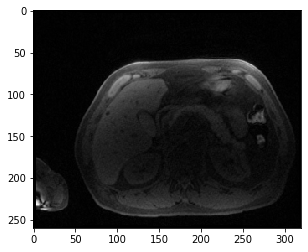

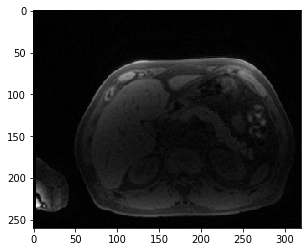

80


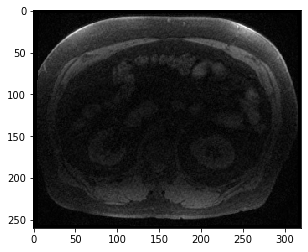

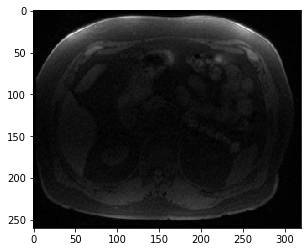

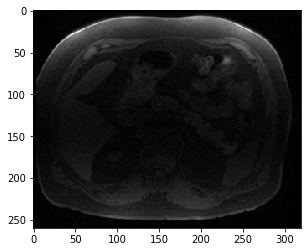

81


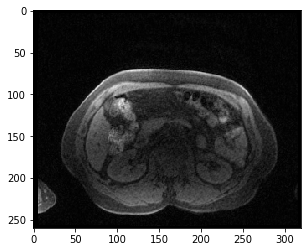

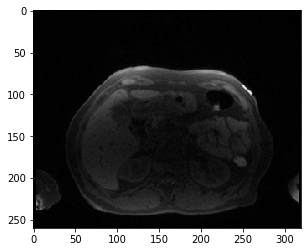

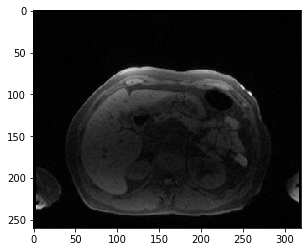

82


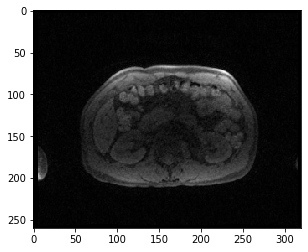

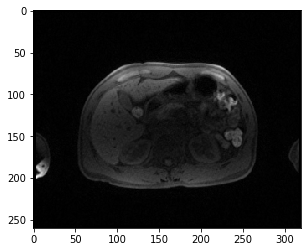

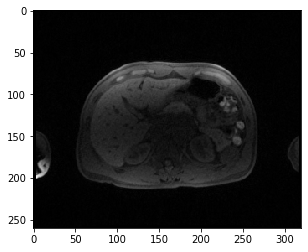

83


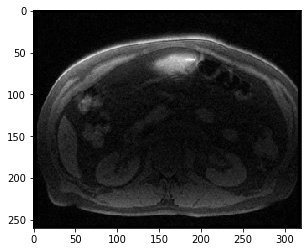

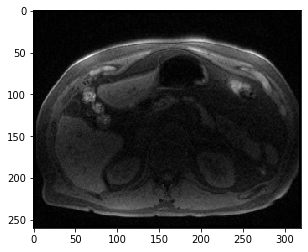

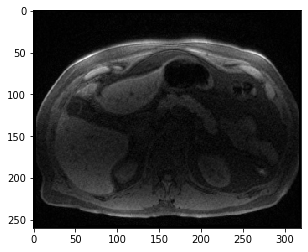

84


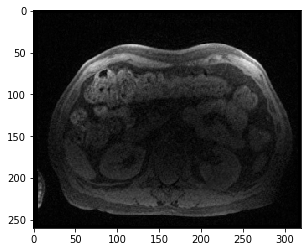

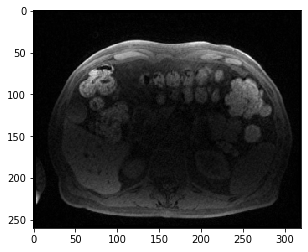

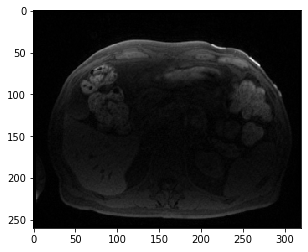

85


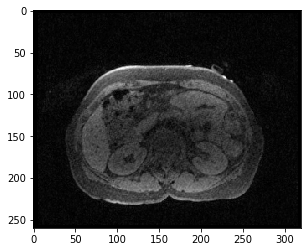

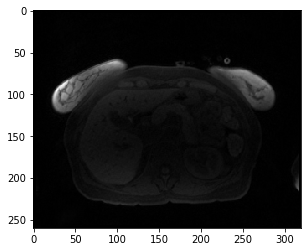

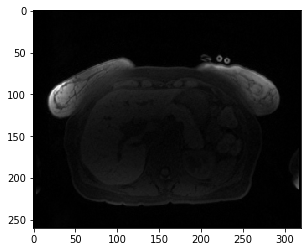

86


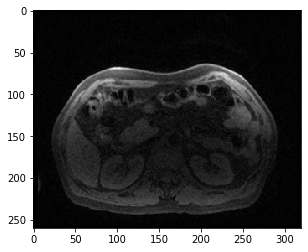

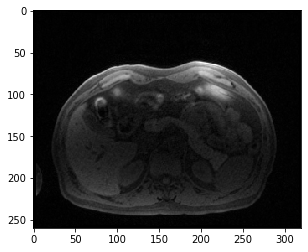

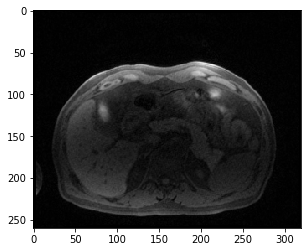

87


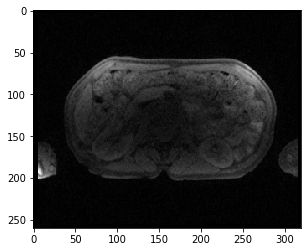

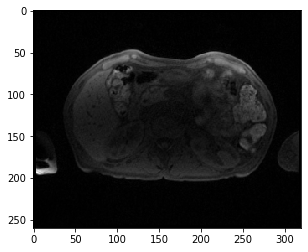

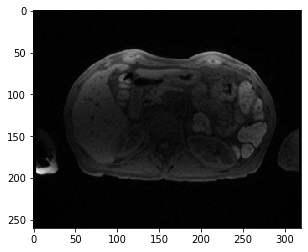

88


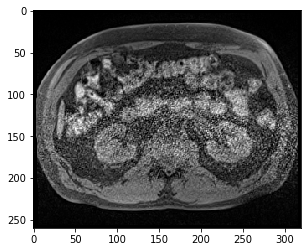

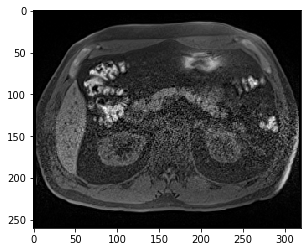

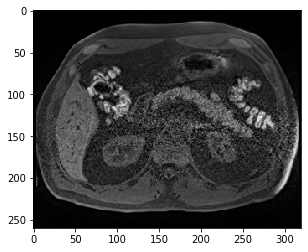

89


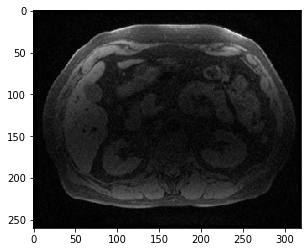

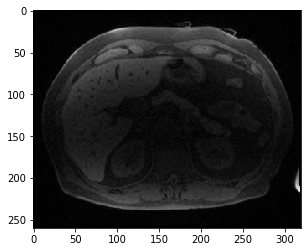

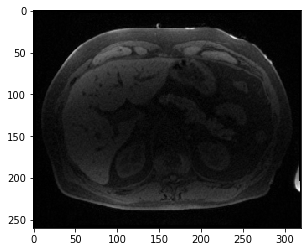

90


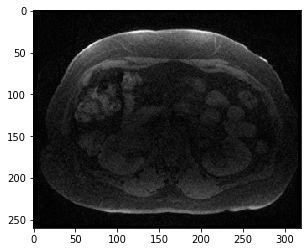

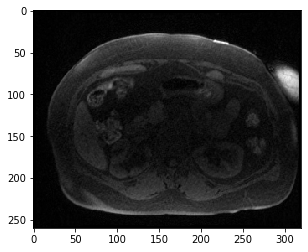

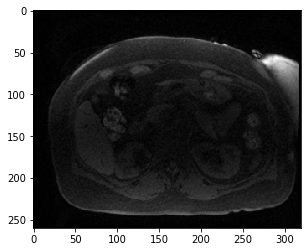

91


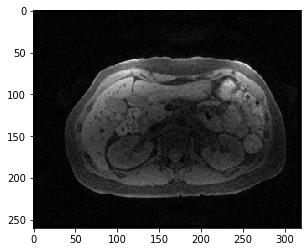

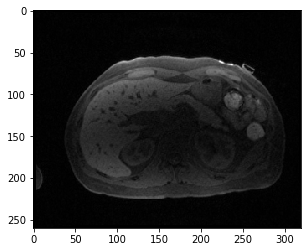

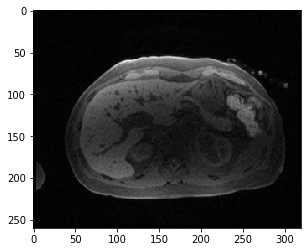

92


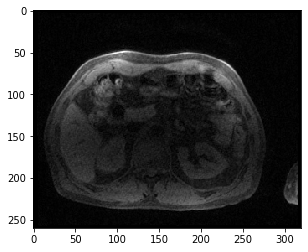

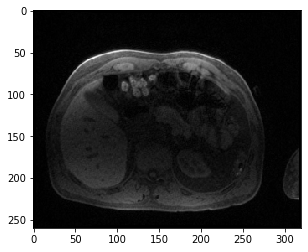

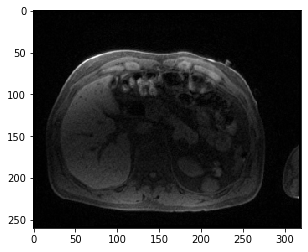

93


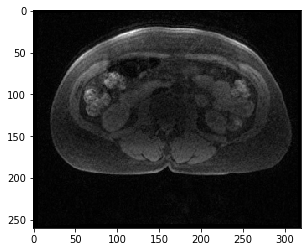

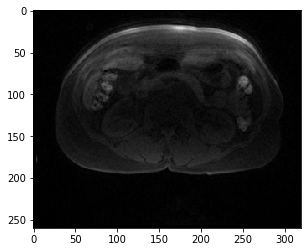

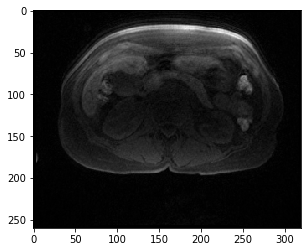

94


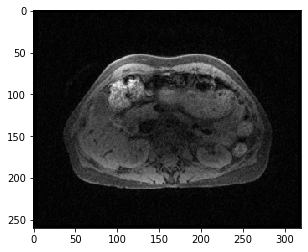

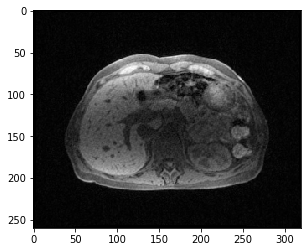

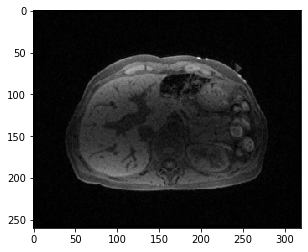

95


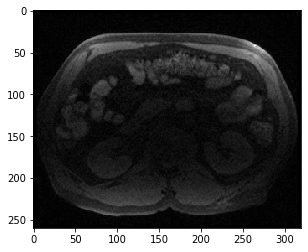

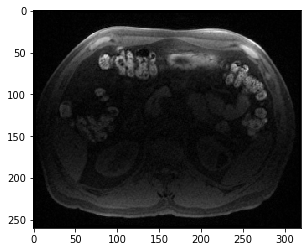

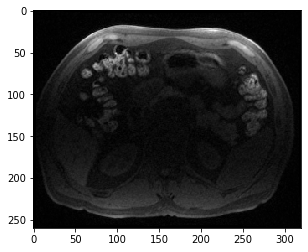

96


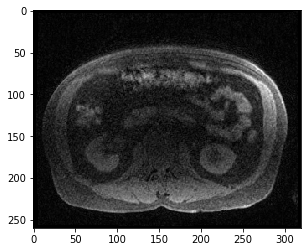

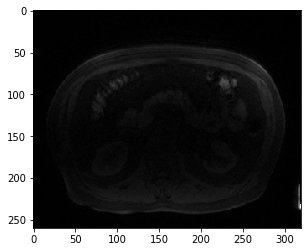

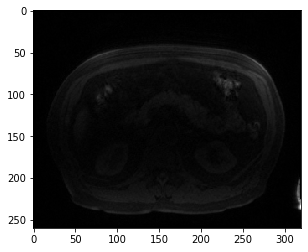

97


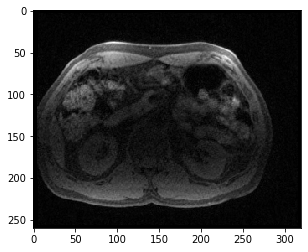

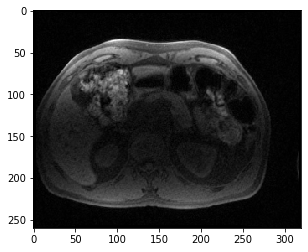

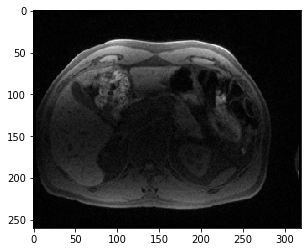

98


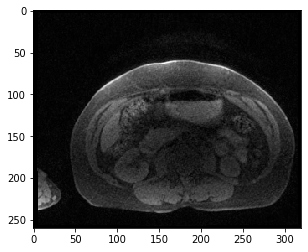

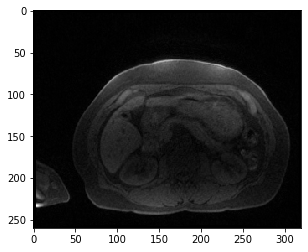

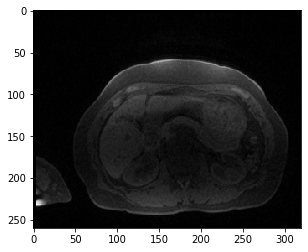

99


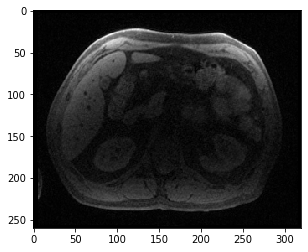

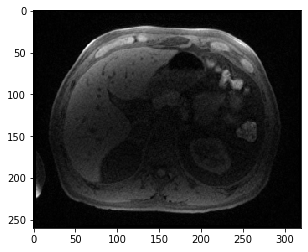

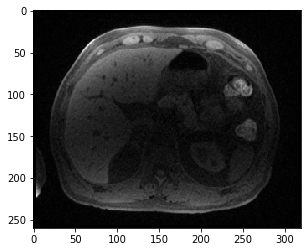

100


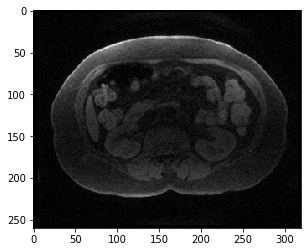

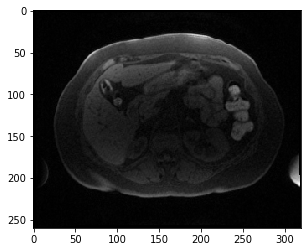

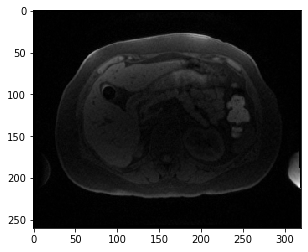

In [4]:
#resized_image = cv2.resize(image_list[1], (128, 128)) / 255.0
vectors = []

counter = 0

for image_list in images.values():
    
    vector = []
    
    counter += 1
    print(counter)
    
    for i in range(3):
        image = image_list[i]
        plt.imshow(image, interpolation='nearest', cmap='gray')
        plt.show() 
    
        cropped_image = image[50:250, 50:300]
        resized_image = cv2.resize(cropped_image, (128, 128)) / 255.0
                
        #plt.imshow(resized_image, interpolation='nearest', cmap='gray')
        #plt.show() 
        
        flattened_image = resized_image.flatten()
        
        vector.append(flattened_image)
            
    vectors.append(np.squeeze(np.reshape(np.asarray(vector),(-1,1))))
    
# coordinates go z y x
#cropped_image = resized_image[50:250, 50:300]


In [29]:
np.asarray(vectors)

array([[0.00784314, 0.00784314, 0.01176471, ..., 0.01176471, 0.02352941,
        0.03921569],
       [0.01568627, 0.01176471, 0.00784314, ..., 0.01568627, 0.01960784,
        0.02352941],
       [0.03529412, 0.17647059, 0.72156863, ..., 0.01960784, 0.02352941,
        0.01960784],
       ...,
       [0.48627451, 0.69803922, 0.51372549, ..., 0.01568627, 0.00784314,
        0.00784314],
       [0.02352941, 0.01568627, 0.01960784, ..., 0.01568627, 0.01176471,
        0.01176471],
       [0.02745098, 0.01176471, 0.01960784, ..., 0.01960784, 0.01960784,
        0.01568627]])

In [35]:
import sklearn.decomposition
pca = sklearn.decomposition.PCA(n_components=100)
pca.fit(np.asarray(vectors))

PCA(copy=True, iterated_power='auto', n_components=100, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

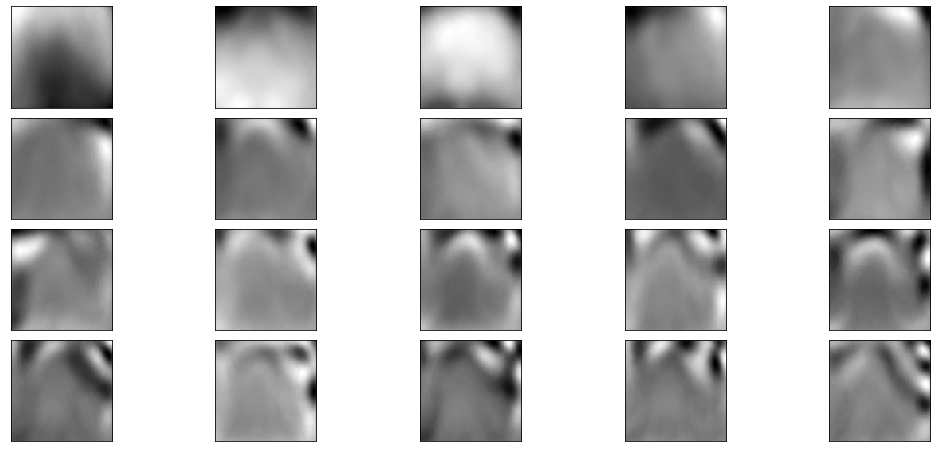

In [5]:
fig, axes = plt.subplots(4, 5, figsize=(18, 8),
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))
for i, ax in enumerate(axes.flat):
    ax.imshow(pca.components_[i].reshape(128, 128), cmap='gray')
plt.show()

In [36]:
# PCS singular values
components = pca.transform(vectors)
components.shape

(32875, 100)

In [7]:
component = components[:, 0]
component.shape

(32875,)

In [37]:
import pandas as pd
df = pd.DataFrame(data=images.keys(),columns=['EID'])
df['EID_2'] = images.keys() 
for i in range(20):
    df['PC'+str(i+1)] = components[:,i]
df

,EID,EID_2,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,...,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
0,2207519,2207519,22.808694,-24.082543,5.603209,16.587626,-2.273906,-13.046458,-5.944355,-2.044608,...,-0.162583,8.814551,5.056648,-4.321576,0.384256,-3.866327,2.176350,2.221106,1.739745,5.145225
1,2586599,2586599,20.128928,-1.826487,-0.957095,-9.212796,6.766623,2.539760,0.830048,-4.844986,...,1.330720,-0.183255,0.733697,-1.168997,0.638563,-1.497757,6.125315,0.786046,-2.741945,-0.655198
2,2506918,2506918,-23.313911,-4.642923,5.297066,6.603003,4.523736,10.414630,-0.070416,-2.559985,...,0.660671,3.440470,-0.091025,-3.155200,2.085110,-5.477066,-1.513526,-1.898608,-1.871359,-3.023262
3,3321320,3321320,7.637820,3.827575,17.377453,-4.934833,-1.649056,5.709939,4.943620,-7.734223,...,-2.161028,-2.462758,2.597672,-0.745043,0.791930,0.840844,-1.647311,-4.093681,0.387385,-0.881837
4,3331687,3331687,6.365501,26.330706,-4.672941,2.974872,-1.825537,-5.600363,3.906709,5.528185,...,10.341738,2.713997,-1.638328,0.316448,5.062688,-0.716548,2.053488,-3.286840,-0.116534,2.730552
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32870,2169866,2169866,-0.355846,27.452759,-14.149597,3.993291,-7.244392,-4.522785,-4.131686,3.802602,...,6.417645,0.994463,-2.650035,-0.004020,4.748590,-3.551147,-2.951331,2.685617,2.998782,5.730735
32871,5989656,5989656,-18.905700,-1.661572,4.199089,2.440841,2.368971,2.404197,-3.428390,2.433621,...,-1.074176,-3.481674,3.824073,-2.796315,-0.946917,-3.826707,-1.886735,-0.887962,-1.816675,-3.516614
32872,2990554,2990554,-17.778775,-6.742253,2.140691,-2.818968,2.558503,6.527604,-0.770638,2.506902,...,2.102505,-0.027199,-1.771278,1.141518,-4.502785,2.219018,-0.591844,2.805648,-1.445185,1.948357
32873,4505547,4505547,-4.608407,18.569950,0.932154,2.726004,-0.950233,-10.061379,5.251457,-0.796497,...,4.952545,0.908327,-2.898542,1.517720,-1.128316,4.930597,1.416904,-3.725096,-0.172901,-1.216974


In [38]:
df.loc[-1] = ['EID', 'EID'] + ['PC'+ str(i+1) for i in range(20)]
df.index = df.index + 1  # shifting index
df.sort_index(inplace=True) 
df

,EID,EID_2,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,...,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
0,EID,EID,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,...,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
1,2207519,2207519,22.8087,-24.0825,5.60321,16.5876,-2.27391,-13.0465,-5.94435,-2.04461,...,-0.162583,8.81455,5.05665,-4.32158,0.384256,-3.86633,2.17635,2.22111,1.73975,5.14522
2,2586599,2586599,20.1289,-1.82649,-0.957095,-9.2128,6.76662,2.53976,0.830048,-4.84499,...,1.33072,-0.183255,0.733697,-1.169,0.638563,-1.49776,6.12532,0.786046,-2.74194,-0.655198
3,2506918,2506918,-23.3139,-4.64292,5.29707,6.603,4.52374,10.4146,-0.0704164,-2.55999,...,0.660671,3.44047,-0.0910249,-3.1552,2.08511,-5.47707,-1.51353,-1.89861,-1.87136,-3.02326
4,3321320,3321320,7.63782,3.82757,17.3775,-4.93483,-1.64906,5.70994,4.94362,-7.73422,...,-2.16103,-2.46276,2.59767,-0.745043,0.79193,0.840844,-1.64731,-4.09368,0.387385,-0.881837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32871,2169866,2169866,-0.355846,27.4528,-14.1496,3.99329,-7.24439,-4.52278,-4.13169,3.8026,...,6.41764,0.994463,-2.65003,-0.00402,4.74859,-3.55115,-2.95133,2.68562,2.99878,5.73074
32872,5989656,5989656,-18.9057,-1.66157,4.19909,2.44084,2.36897,2.4042,-3.42839,2.43362,...,-1.07418,-3.48167,3.82407,-2.79632,-0.946917,-3.82671,-1.88673,-0.887962,-1.81667,-3.51661
32873,2990554,2990554,-17.7788,-6.74225,2.14069,-2.81897,2.5585,6.5276,-0.770638,2.5069,...,2.1025,-0.0271988,-1.77128,1.14152,-4.50278,2.21902,-0.591844,2.80565,-1.44519,1.94836
32874,4505547,4505547,-4.60841,18.57,0.932154,2.726,-0.950233,-10.0614,5.25146,-0.796497,...,4.95255,0.908327,-2.89854,1.51772,-1.12832,4.9306,1.4169,-3.7251,-0.172901,-1.21697


In [39]:
df.to_csv(basePath+'all_patients.csv', sep ='\t', index=False, header=False)
pd.read_csv(basePath+'all_patients.csv',header=None)

,0
0,EID\tEID\tPC1\tPC2\tPC3\tPC4\tPC5\tPC6\tPC7\tP...
1,2207519\t2207519\t22.808693509532223\t-24.0825...
2,2586599\t2586599\t20.12892840846243\t-1.826487...
3,2506918\t2506918\t-23.313910523691032\t-4.6429...
4,3321320\t3321320\t7.6378202124226355\t3.827574...
...,...
32871,2169866\t2169866\t-0.3558456333818674\t27.4527...
32872,5989656\t5989656\t-18.90570047442998\t-1.66157...
32873,2990554\t2990554\t-17.778775432977838\t-6.7422...
32874,4505547\t4505547\t-4.608407357587868\t18.56995...
